## Introduction

**What is real estate?**<br>
Real estate is a business related to buying and selling land and buildings on it.

**What will be done in this project?**<br>
Conducting an analysis of the "USA Real Estate Dataset" data taken from *kaggle*, by producing the output of a model that can predict real estate prices with certain variables.

**Dataset**<br>
Dataset that used in this project is taken from *kaggle* : https://www.kaggle.com/datasets/ahmedshahriarsakib/usa-real-estate-dataset?datasetId=2218738&sortBy=voteCount&language=Python&select=realtor-data.csv

**Columns**
status       : Housing Status (on sale or other option)
price        : Price in USD
bed          : Bedroom count
bath         : Bathroom count
acre_lot     : Acre lot
full_address : Full address
street       : Street name
city         : City name
state        : State name
zip_code     : Zip Code
house_size   : House size in sqft (square feet)
sold_date    : The date when the house is sold

**Data was scraped from**

https://www.realtor.com/ - A real estate listings website operated by the News Corp subsidiary Move, Inc. and based in Santa Clara, California. It is the second most visited real estate listings website in the United States as of 2021, with over 100 million monthly active users.

## Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from collections.abc import Iterable
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.kernel_ridge import KernelRidge
from xgboost.sklearn import XGBRegressor
from lightgbm import LGBMRegressor
from sklearn.linear_model import LinearRegression, Lasso, Ridge, BayesianRidge, SGDRegressor, ElasticNet
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import LinearSVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.neural_network import MLPRegressor

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.model_selection import RepeatedKFold
from sklearn.model_selection import RandomizedSearchCV

## Data Exploration

In [2]:
df = pd.read_csv('realtor-data.csv')
df.head()

,status,price,bed,bath,acre_lot,full_address,street,city,state,zip_code,house_size,sold_date
0,for_sale,105000.0,3.0,2.0,0.12,"Sector Yahuecas Titulo # V84, Adjuntas, PR, 00601",Sector Yahuecas Titulo # V84,Adjuntas,Puerto Rico,601.0,920.0,NaN
1,for_sale,80000.0,4.0,2.0,0.08,"Km 78 9 Carr # 135, Adjuntas, PR, 00601",Km 78 9 Carr # 135,Adjuntas,Puerto Rico,601.0,1527.0,NaN
2,for_sale,67000.0,2.0,1.0,0.15,"556G 556-G 16 St, Juana Diaz, PR, 00795",556G 556-G 16 St,Juana Diaz,Puerto Rico,795.0,748.0,NaN
3,for_sale,145000.0,4.0,2.0,0.10,"R5 Comunidad El Paraso Calle De Oro R-5 Ponce,...",R5 Comunidad El Paraso Calle De Oro R-5 Ponce,Ponce,Puerto Rico,731.0,1800.0,NaN
4,for_sale,65000.0,6.0,2.0,0.05,"14 Navarro, Mayaguez, PR, 00680",14 Navarro,Mayaguez,Puerto Rico,680.0,NaN,NaN


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 923159 entries, 0 to 923158
Data columns (total 12 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   status        923159 non-null  object 
 1   price         923088 non-null  float64
 2   bed           791456 non-null  float64
 3   bath          807967 non-null  float64
 4   acre_lot      649536 non-null  float64
 5   full_address  923159 non-null  object 
 6   street        921021 non-null  object 
 7   city          923085 non-null  object 
 8   state         923159 non-null  object 
 9   zip_code      922954 non-null  float64
 10  house_size    625316 non-null  float64
 11  sold_date     456396 non-null  object 
dtypes: float64(6), object(6)
memory usage: 84.5+ MB


In [4]:
df.shape

(923159, 12)

This dataset has 923159 data rows and 12 columns

In [5]:
df.duplicated().sum()

809370

This dataset has 809370 duplicate data, around 87% of the dataset.

#### Remove Duplicate Data

In [6]:
df.drop_duplicates(inplace=True)
df.shape

(113789, 12)

#### Missing Values

In [7]:
df.isnull().sum()

status              0
price              18
bed             17516
bath            16297
acre_lot        31123
full_address        0
street            511
city               23
state               0
zip_code           33
house_size      36448
sold_date       54092
dtype: int64

In [8]:
df_nonull = df.dropna()

In [9]:
df.dropna(subset=["price", "street", "bed", "bath", "acre_lot", "city", "zip_code", "house_size"],inplace=True)

In [10]:
df.isnull().sum()

status              0
price               0
bed                 0
bath                0
acre_lot            0
full_address        0
street              0
city                0
state               0
zip_code            0
house_size          0
sold_date       20608
dtype: int64

#### Remove Special Characters and Convert "sold_date" column to date format

In [11]:
df.head()

,status,price,bed,bath,acre_lot,full_address,street,city,state,zip_code,house_size,sold_date
0,for_sale,105000.0,3.0,2.0,0.12,"Sector Yahuecas Titulo # V84, Adjuntas, PR, 00601",Sector Yahuecas Titulo # V84,Adjuntas,Puerto Rico,601.0,920.0,NaN
1,for_sale,80000.0,4.0,2.0,0.08,"Km 78 9 Carr # 135, Adjuntas, PR, 00601",Km 78 9 Carr # 135,Adjuntas,Puerto Rico,601.0,1527.0,NaN
2,for_sale,67000.0,2.0,1.0,0.15,"556G 556-G 16 St, Juana Diaz, PR, 00795",556G 556-G 16 St,Juana Diaz,Puerto Rico,795.0,748.0,NaN
3,for_sale,145000.0,4.0,2.0,0.10,"R5 Comunidad El Paraso Calle De Oro R-5 Ponce,...",R5 Comunidad El Paraso Calle De Oro R-5 Ponce,Ponce,Puerto Rico,731.0,1800.0,NaN
5,for_sale,179000.0,4.0,3.0,0.46,"Bo Calabazas San Sebastian, San Sebastian, PR,...",Bo Calabazas San Sebastian,San Sebastian,Puerto Rico,612.0,2520.0,NaN


In [12]:
df["sold_date"]=pd.to_datetime(df["sold_date"])

In [13]:
df['full_address'] = df['full_address'].str.replace (r"""[^\w\s]+""","")
df['street'] = df['street'].str.replace (r"""[^\w\s]+""","")

C:\Users\vince\AppData\Local\Temp\ipykernel_25548\1112929317.py:1: FutureWarning: The default value of regex will change from True to False in a future version.
  df['full_address'] = df['full_address'].str.replace (r"""[^\w\s]+""","")
C:\Users\vince\AppData\Local\Temp\ipykernel_25548\1112929317.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  df['street'] = df['street'].str.replace (r"""[^\w\s]+""","")


In [14]:
df.head()

,status,price,bed,bath,acre_lot,full_address,street,city,state,zip_code,house_size,sold_date
0,for_sale,105000.0,3.0,2.0,0.12,Sector Yahuecas Titulo V84 Adjuntas PR 00601,Sector Yahuecas Titulo V84,Adjuntas,Puerto Rico,601.0,920.0,NaT
1,for_sale,80000.0,4.0,2.0,0.08,Km 78 9 Carr 135 Adjuntas PR 00601,Km 78 9 Carr 135,Adjuntas,Puerto Rico,601.0,1527.0,NaT
2,for_sale,67000.0,2.0,1.0,0.15,556G 556G 16 St Juana Diaz PR 00795,556G 556G 16 St,Juana Diaz,Puerto Rico,795.0,748.0,NaT
3,for_sale,145000.0,4.0,2.0,0.10,R5 Comunidad El Paraso Calle De Oro R5 Ponce P...,R5 Comunidad El Paraso Calle De Oro R5 Ponce,Ponce,Puerto Rico,731.0,1800.0,NaT
5,for_sale,179000.0,4.0,3.0,0.46,Bo Calabazas San Sebastian San Sebastian PR 00612,Bo Calabazas San Sebastian,San Sebastian,Puerto Rico,612.0,2520.0,NaT


#### Exploratory Data Analysis

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 53384 entries, 0 to 923147
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   status        53384 non-null  object        
 1   price         53384 non-null  float64       
 2   bed           53384 non-null  float64       
 3   bath          53384 non-null  float64       
 4   acre_lot      53384 non-null  float64       
 5   full_address  53384 non-null  object        
 6   street        53384 non-null  object        
 7   city          53384 non-null  object        
 8   state         53384 non-null  object        
 9   zip_code      53384 non-null  float64       
 10  house_size    53384 non-null  float64       
 11  sold_date     32776 non-null  datetime64[ns]
dtypes: datetime64[ns](1), float64(6), object(5)
memory usage: 5.3+ MB


In [16]:
df.shape

(53384, 12)

#### State Count

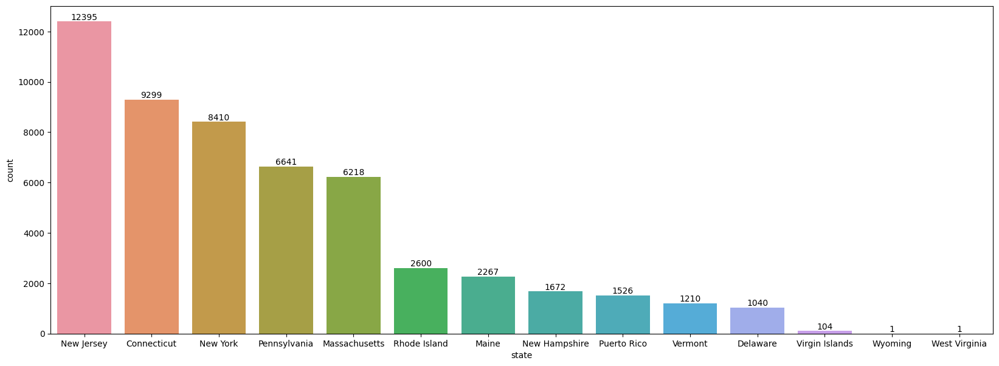

In [17]:
plt.figure(figsize=(20,7))
ax = sns.countplot(x = df['state'], order = df['state'].value_counts().index)
ax = ax.bar_label(ax.containers[0])

**The highest repeat State in US** <br>
1. New Jersey 23%<br>
2. Connecticut 17%<br>
3. New York 15%<br>
4. Pennsylvania 12%<br>
5. Massachusetts 11%<br>
6. Rhode Island 4%<br>
7. Maine 4%<br>
8. New Hampshire 3%<br>
9. Puerto Rico 2%<br>
10. Vermont 2%<br>
11. Delaware 1%<br>
12. Virgin Islands 0.19%<br>
13. Wyoming 0.001%<br>
14. West Virginia 0.001%<br>

In [19]:
from plotly.offline import iplot, init_notebook_mode
import plotly.express as px

init_notebook_mode(connected=True)

#### House Size and Price

In [20]:
fig = px.scatter(df, x="house_size", y="price", trendline="ols", color='price', title='Total Square Feet and its Price')
fig.show()

Seen from the graph above, there are several outliers, because the total square feet offered at an unreasonable price. Therefore, the outlier will be discarded

In [21]:
df_sorted = df.sort_values(by='house_size', ascending=False)
df_sorted.head()

,status,price,bed,bath,acre_lot,full_address,street,city,state,zip_code,house_size,sold_date
10328,for_sale,8250000.0,5.0,6.0,33.29,PR250 Int Culebra PR 00775,PR250 Int,Culebra,Puerto Rico,775.0,1450112.0,NaT
475143,for_sale,489999.0,6.0,3.0,0.10,814 Cleveland Ave Unit 2 Linden NJ 07036,814 Cleveland Ave Unit 2,Linden,New Jersey,7036.0,400149.0,NaT
922334,for_sale,69999.0,1.0,1.0,2.80,315 King St Apt 3J Port Chester NY 10573,315 King St Apt 3J,Port Chester,New York,10573.0,112714.0,NaT
914234,for_sale,825000.0,5.0,3.0,0.28,1540 Coolidge Ave North Baldwin NY 11510,1540 Coolidge Ave,North Baldwin,New York,11510.0,85142.0,2015-11-20
635272,for_sale,169000.0,3.0,1.0,0.02,3630 Winchester Ave Atlantic City NJ 08401,3630 Winchester Ave,Atlantic City,New Jersey,8401.0,70626.0,2017-12-27


In [22]:
df = df.drop([10328, 475143, 922334])

In [23]:
df_sorted = df.sort_values(by='price', ascending=False)
df_sorted.head()

,status,price,bed,bath,acre_lot,full_address,street,city,state,zip_code,house_size,sold_date
734849,for_sale,169000000.0,6.0,9.0,0.79,432 Park Ave Unit Penthouse New York City NY 1...,432 Park Ave Unit Penthouse,New York City,New York,10022.0,8255.0,NaT
459321,for_sale,100000000.0,10.0,10.0,60.92,Great Is Darien CT 06820,Great Is,Darien,Connecticut,6820.0,13107.0,NaT
459320,for_sale,100000000.0,10.0,10.0,60.92,19 Great Is Darien CT 06820,19 Great Is,Darien,Connecticut,6820.0,13107.0,NaT
836539,for_sale,65000000.0,8.0,10.0,0.05,25 Riverside Dr New York City NY 10023,25 Riverside Dr,New York City,New York,10023.0,12000.0,NaT
40599,for_sale,60000000.0,9.0,10.0,400.00,450 Brickyard Rd Woodstock CT 06281,450 Brickyard Rd,Woodstock,Connecticut,6281.0,18777.0,2003-08-28


In [24]:
df = df.drop([734849, 459320, 459321])

#### Bed and Price

In [26]:
fig = px.scatter(df_nonull, x="bed", y="price", trendline="ols", color='price', title='Number of Beds and its Price')
fig.show()

#### Bath and Price

In [27]:
fig = px.scatter(df_nonull, x="bath", y="price", trendline="ols", color='price', title='Number of Baths and its Price')
fig.show()

#### State Ranking by highest mean house price

In [28]:
order = df.groupby(by=['state'])['price'].mean().round(2).sort_values(ascending=False).index

fig = px.box(df, x="state", y="price", points='all', color='state', title='Highest City House Prizes Ranking by Mean')
fig.update_xaxes(categoryorder='array', categoryarray= list(order))
fig.show()

#### Heatmap

In [29]:
fig = px.imshow(df_nonull.corr(), title='Heatmap of numerical values of the data')
fig.show()

C:\Users\vince\AppData\Local\Temp\ipykernel_25548\4137097140.py:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



From the heatmap above, the price columns has a moderate correlation to bath and house_size, that can increase the r2 score for modeling.

#### Data Preparation

In [30]:
df.head()

,status,price,bed,bath,acre_lot,full_address,street,city,state,zip_code,house_size,sold_date
0,for_sale,105000.0,3.0,2.0,0.12,Sector Yahuecas Titulo V84 Adjuntas PR 00601,Sector Yahuecas Titulo V84,Adjuntas,Puerto Rico,601.0,920.0,NaT
1,for_sale,80000.0,4.0,2.0,0.08,Km 78 9 Carr 135 Adjuntas PR 00601,Km 78 9 Carr 135,Adjuntas,Puerto Rico,601.0,1527.0,NaT
2,for_sale,67000.0,2.0,1.0,0.15,556G 556G 16 St Juana Diaz PR 00795,556G 556G 16 St,Juana Diaz,Puerto Rico,795.0,748.0,NaT
3,for_sale,145000.0,4.0,2.0,0.10,R5 Comunidad El Paraso Calle De Oro R5 Ponce P...,R5 Comunidad El Paraso Calle De Oro R5 Ponce,Ponce,Puerto Rico,731.0,1800.0,NaT
5,for_sale,179000.0,4.0,3.0,0.46,Bo Calabazas San Sebastian San Sebastian PR 00612,Bo Calabazas San Sebastian,San Sebastian,Puerto Rico,612.0,2520.0,NaT


In [31]:
df.isnull().sum()

status              0
price               0
bed                 0
bath                0
acre_lot            0
full_address        0
street              0
city                0
state               0
zip_code            0
house_size          0
sold_date       20602
dtype: int64

I will drop *sold_date* collumns because there was too much of missing values. <br>Also i will drop *full_address* collumns because, it only stores complete data that already exists in the street, city, state, zip code columns

In [32]:
new_df = df.drop(columns=["sold_date", "full_address"])
new_df.isnull().sum()

status        0
price         0
bed           0
bath          0
acre_lot      0
street        0
city          0
state         0
zip_code      0
house_size    0
dtype: int64

There's no more missing value on the dataset

In [33]:
new_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 53378 entries, 0 to 923147
Data columns (total 10 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   status      53378 non-null  object 
 1   price       53378 non-null  float64
 2   bed         53378 non-null  float64
 3   bath        53378 non-null  float64
 4   acre_lot    53378 non-null  float64
 5   street      53378 non-null  object 
 6   city        53378 non-null  object 
 7   state       53378 non-null  object 
 8   zip_code    53378 non-null  float64
 9   house_size  53378 non-null  float64
dtypes: float64(6), object(4)
memory usage: 4.5+ MB


#### Label Encoder for categorical features

In [34]:
# Separate dataset
categorical = []
numeric = []
for columns in new_df.columns:
    if new_df[columns].dtypes == 'O':
        categorical.append(columns)
    else:
        numeric.append(columns)

data_numeric=new_df[numeric]
data_categorical=new_df[categorical] 

In [35]:
col = data_categorical.columns
label_encoders = {}
categorical_columns = data_categorical.columns

for column in categorical_columns:
    label_encoders[column] = LabelEncoder()
    data_categorical[column] = label_encoders[column].fit_transform(data_categorical[column])

C:\Users\vince\AppData\Local\Temp\ipykernel_25548\2958306908.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [36]:
# Combine categorical and numeric dataframe
frames = [data_categorical, data_numeric]
  
data = pd.concat(frames,axis=1)
data.head()

,status,street,city,state,price,bed,bath,acre_lot,zip_code,house_size
0,0,52557,11,8,105000.0,3.0,2.0,0.12,601.0,920.0
1,0,52204,11,8,80000.0,4.0,2.0,0.08,601.0,1527.0
2,0,39649,952,8,67000.0,2.0,1.0,0.15,795.0,748.0
3,0,52504,1569,8,145000.0,4.0,2.0,0.10,731.0,1800.0
5,0,51648,1736,8,179000.0,4.0,3.0,0.46,612.0,2520.0


#### Separate Training and Testing Data

In [37]:
#Defined X value and y value , and split the data train
X = data.drop(columns="price")           
y = data["price"] 

# split the data train and test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print("X Train : ", X_train.shape)
print("X Test  : ", X_test.shape)
print("Y Train : ", y_train.shape)
print("Y Test  : ", y_test.shape)

X Train :  (42702, 9)
X Test  :  (10676, 9)
Y Train :  (42702,)
Y Test  :  (10676,)


## Training Models

In [38]:
#Defined object from library Regression 

LR = LinearRegression()
DTR = DecisionTreeRegressor()
RFR = RandomForestRegressor()
KNR = KNeighborsRegressor()
MLP = MLPRegressor()
XGB = XGBRegressor()
LS = Lasso()
RDG = Ridge()
BRDG = BayesianRidge()
LSVR = LinearSVR()
GBR = GradientBoostingRegressor()
EN = ElasticNet()
SGDR = SGDRegressor()

In [39]:
# make for loop for Regression 

li = [LR,DTR,RFR,KNR,KNR,XGB,LS,RDG,BRDG,LSVR,GBR,EN,SGDR]
d = {}
for i in li:
    i.fit(X_train,y_train)
    ypred = i.predict(X_test)
    print(i,":",r2_score(y_test,ypred))
    d.update({str(i):i.score(X_test,y_test)*100})

LinearRegression() : 0.3062430057000245
DecisionTreeRegressor() : 0.4083432152576453
RandomForestRegressor() : 0.7061207170469777
KNeighborsRegressor() : 0.3077902415519196
KNeighborsRegressor() : 0.3077902415519196
XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=None, ...) : 0.7349306380701855
Lasso() : 0.3062429000

c:\Users\vince\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\svm\_base.py:1244: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.



LinearSVR() : 0.1403317405474953
GradientBoostingRegressor() : 0.6260180894717519
ElasticNet() : 0.2898931803217708
SGDRegressor() : -1.3168986502733163e+21


#### Final result of the r2 score for all algorithms

In [40]:
for result in d:
    print(f"{result} : {d[result].round(2)}%")

LinearRegression() : 30.62%
DecisionTreeRegressor() : 40.83%
RandomForestRegressor() : 70.61%
KNeighborsRegressor() : 30.78%
XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=None, ...) : 73.49%
Lasso() : 30.62%
Ridge() : 30.62%
BayesianRidge() : 30.62%
LinearSVR() : 14.03%
GradientBoostingRegressor() : 62.6%
ElasticNe

From the results of training various models above, the model with the highest r2 score is XGBRegressor, with 0.7349306380701855 or 73.49%.

## XGBRegressor Model Evaluation

#### Feature Importance

<AxesSubplot: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

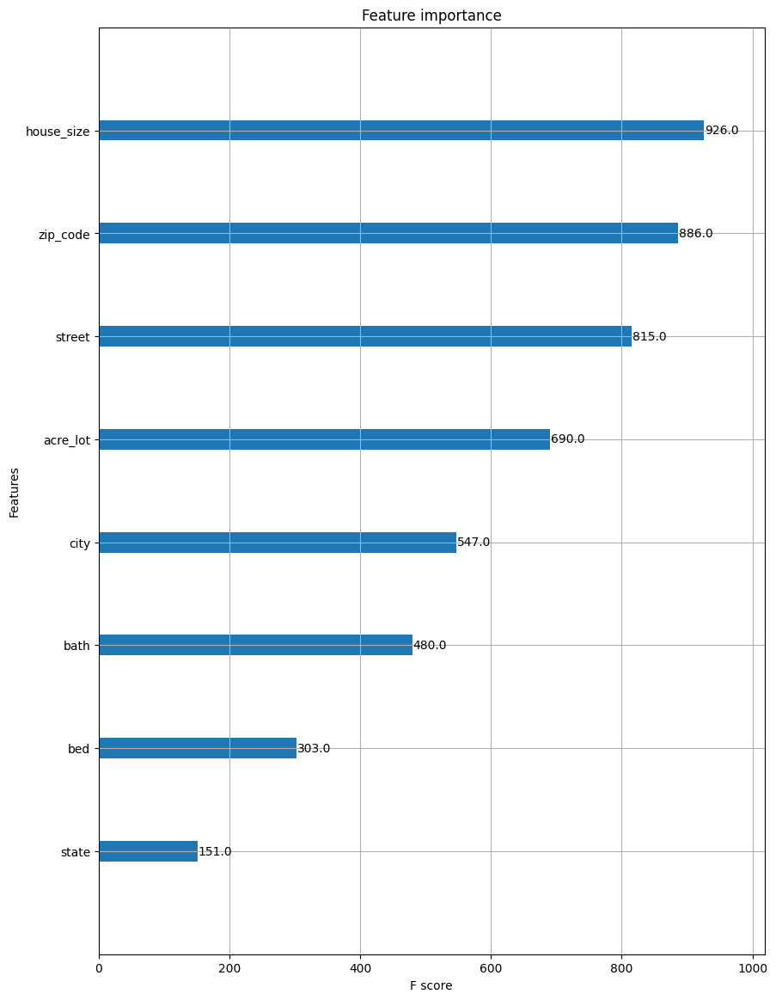

In [41]:
from xgboost import plot_importance

model = XGBRegressor()
model.fit(X_train, y_train)
def plot_features(booster, figsize):    
    fig, ax = plt.subplots(1,1,figsize=figsize)
    return plot_importance(booster=booster, ax=ax)
plot_features(model, (10,14))

#### MEA, MSE, and r2 Score

In [45]:
y_pred = model.predict(X_test)
print('Mean Absolute Error: ', mean_absolute_error(y_test, y_pred))
print('Mean Squared Error: ', mean_squared_error(y_test, y_pred))
print('r2: ', r2_score(y_test, y_pred))

Mean Absolute Error:  247295.57751304767
Mean Squared Error:  523555782491.4949
r2:  0.7349306380701855


#### Predictions vs Actual Values

In [43]:
preds = pd.DataFrame({'y_pred': y_pred, 'y_test':y_test})
preds = preds.sort_values(by='y_test')
preds = preds.reset_index()

In [44]:
fig = px.line(preds, x=preds.index, y=preds.columns[1::], title='Predictions vs Actual Value')
fig.show()